<a href="https://colab.research.google.com/github/ugepet/IBM_Watson_Studio_Projects/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Mount the drive
from google.colab import drive
drive.mount('/content/gdrive')


Mounted at /content/gdrive


In [ ]:
#To Unzip the file and save in the folder dog_vision in google drive
# !unzip gdrive/My\ Drive/dog_vision/dog-breed-identification.zip -d "gdrive/My Drive/dog_vision"


### We have downloaded our data into google colab. So we will now go about working on the dataset to achieve our goal of dog classification. **So this notebook builts and end-to-end multi-class image classifier Using TensorFlow 2,0 and TensorFlow Hub**

## 1. Problem Definition
Identifying the breed of a dog given an image of a dog

## 2. Data
The data we are using is from Kaggle dog-breed-identification competition: https://www.kaggle.com/competitions/dog-breed-identification/overview

## 3. Evaluation
The evaluation is a file with prediction probabilities for each dog breed of each test image. https://www.kaggle.com/competitions/dog-breed-identification/overview/evaluation

## 4. Features
Some information about the data:
* We are dealing with images(Unstructured data). So it's probably best we use deep learning/transfer learning
* There 120 breeds of dogs (This means there are 120 different classes).
* There areound 10,000 images in the training set(These images have labels)
*There around 10,000 images in the test set (These images has no labels because we want to predict them)

## Get Our Workspace Ready
* import tensorflow
* import tensorflow Hub
* make sure we are using a GPU

**Import necessary Tools**


In [ ]:
# Import TnsorFlow into Colab
import tensorflow as tf
print("TF Version:", tf.__version__)
import tensorflow_hub as hub
print("TF Hub Version:", hub.__version__)

# Check for GPU Availability
print("GPU", "available (YESSSS!!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(") 

TF Version: 2.8.0
TF Hub Version: 0.12.0
GPU available (YESSSS!!!!!)


**If GPU is not Available, To make GPU available, click on "Runtime" tab, then select "change runtime type" and change the "Hardware accelerator" to GPU**

## Getting our images ready. (Turning into tensors)
**With all machine learning models, our data has to be in numerical format. So that is what we will be doing first. Turning our images into tensors(numerical representation)**

In [ ]:
# Ensure you mount your gdrive to be able to access the files on your google drive
import pandas as pd
labels = pd.read_csv("gdrive/My Drive/dog_vision/labels.csv")
labels.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
print(labels.describe())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126


In [ ]:
#Check how many images are there of each breed
labels.breed.value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
golden_retriever         67
brabancon_griffon        67
komondor                 67
eskimo_dog               66
briard                   66
Name: breed, Length: 120, dtype: int64

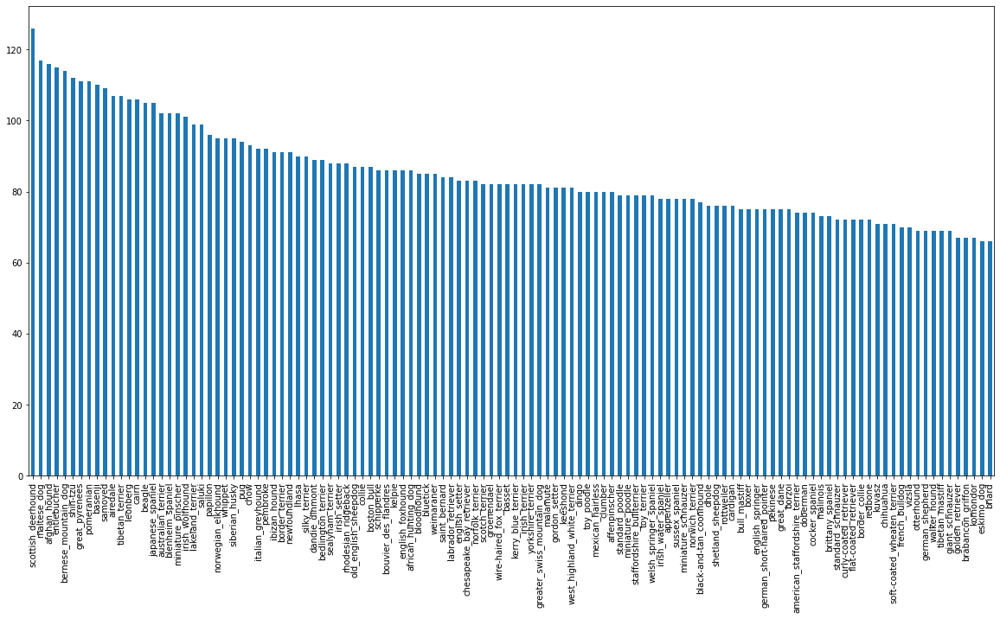

In [ ]:
#view in a bar chart
labels.breed.value_counts().plot.bar(figsize= (20, 10));

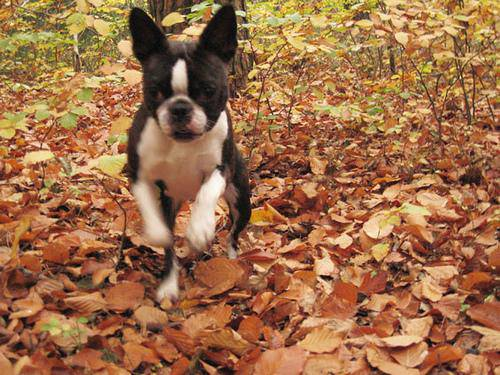

In [ ]:
#Let's view an image
from IPython.display import Image
Image("gdrive/My Drive/dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

### Getting Images and their lables
Let's get a list of all of our images pathnames


In [ ]:
filenames = ["gdrive/My Drive/dog_vision/train/" + fname + ".jpg" for fname in labels["id"]]
filenames[:10]

['gdrive/My Drive/dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'gdrive/My Drive/dog_vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'gdrive/My Drive/dog_vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'gdrive/My Drive/dog_vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'gdrive/My Drive/dog_vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'gdrive/My Drive/dog_vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'gdrive/My Drive/dog_vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'gdrive/My Drive/dog_vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'gdrive/My Drive/dog_vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'gdrive/My Drive/dog_vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
#Check if number of file names matches actual number of image files
import os
if len(os.listdir("gdrive/My Drive/dog_vision/train")) == len(filenames):
  print("filenales matches actual number of files. Proceed")
else:
  print("filenames do not match the actual number of files. Check the target directory")


filenales matches actual number of files. Proceed


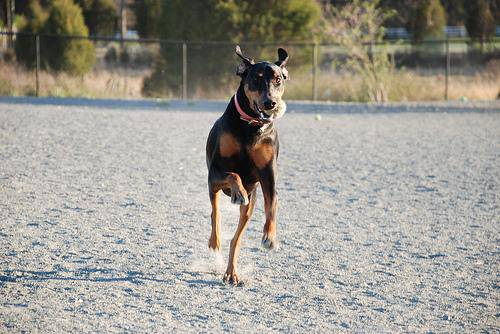

In [ ]:
# One more check
Image(filenames[9099])

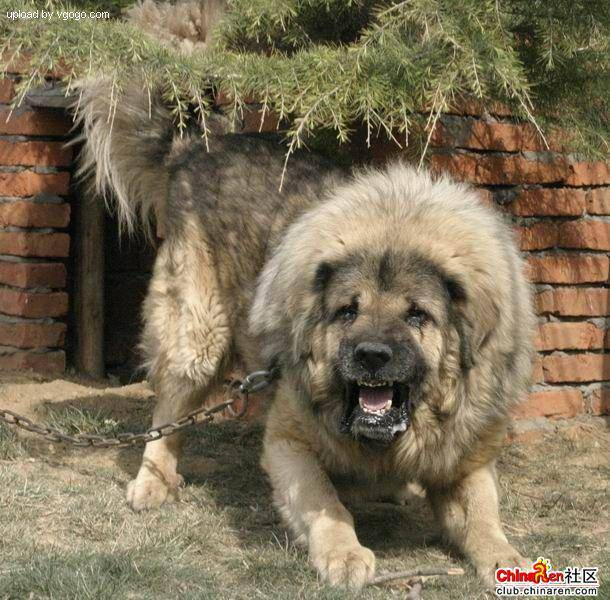

In [ ]:
Image("gdrive/My Drive/dog_vision/train/e20e32bf114141e20a1af854ca4d0ecc.jpg")

In [ ]:
labels["breed"][9000]

'tibetan_mastiff'

Since we now have our training image filepaths in a list, let's prepare our labels

In [ ]:
#Turn the labels into numpy array of string values
import numpy as np
new_labels = labels["breed"].to_numpy()
# new_lables = np_array(labels) does same thing as above

new_labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
if len(new_labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("number of labels does not match the number of filenames. check data directories")

Number of labels matches number of filenames!


In [ ]:
# Find the unique labels values
unique_breed = np.unique(new_labels)
len(unique_breed)

120

In [ ]:
#turn a single label into an array of boolean values
print(new_labels[0] == unique_breed)

[False False False False False False False False False False False False
 False False False False False False False  True False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False]


In [ ]:
#Turn every label into array of boolean values
bool_labels =[label == unique_breed for label in new_labels]

In [ ]:
bool_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
len(bool_labels)

10222

In [ ]:
#Example: turning boolean arrays into integers
print(new_labels[0]) #original lable
print(np.where(unique_breed == new_labels[0])) # Index where label occurs
print(bool_labels[0].argmax()) #index where label occurs in boolean array
print(bool_labels[0].astype(int)) # there will be a 1 where the sample label occur

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our own validation set.
Since the dataset from kaggle did not include a validation set, we are going to create our own.

In [ ]:
# Setup x and y variables
x = filenames
y = bool_labels


Wea are going to start with ~1000 images and increase as needed. This is adviced when working on a large set of data. start with a fraction of the data and increase as the need arises till you perfect your model. 

In [ ]:
#set the number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000} 

In [ ]:
# Let's split our data into train and validation sets
from sklearn.model_selection import train_test_split

#split the data into to sets of the total size of NUM_IMAGES
x_train, x_valid, y_train, y_valid = train_test_split(x[:NUM_IMAGES], y[:NUM_IMAGES], test_size=0.2, random_state=42)

In [ ]:
#check for uniformity of number of datasets
len(x_train), len(x_valid), len(y_train), len(y_valid)

(800, 200, 800, 200)

### Preprocessing Images(Turning images into Tensors)

To preprocess our images into tensors, we are going to write a function which does a few things:
1. Take an image filepath as an input
2. Use TensorFlow to read the file and save it to variable 'image'
3. Turn our 'image' (a jpg) into Tensors
4. Resize the 'image' to be a shape of (224, 224)
5. Return the modified 'image'

This function will be specific to images but the concept remain the same. 

Before we continue, let's see what importing an image looks like



In [ ]:
#converting an image to NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [ ]:
image[:1]

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]]], dtype=uint8)

In [ ]:
# Turn image into tensors so as to run faster in a GPU
tf.constant(image)[:1]

<tf.Tensor: shape=(1, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]]], dtype=uint8)>

Now we've seen what an image looks like as a tensor let's build a function to preprocess them by doing the following:
1. Take an image filepath as an input
2. Use TensorFlow to read the file and save it to variable 'image'
3. Turn our 'image' (a jpg) into Tensors
4. Resize the 'image' to be a shape of (224, 224)
5. Return the modified 'image'


In [ ]:
# Define image size
IMG_SIZE = 224

#Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes and Image file path and turns the image into a tensor
  """
  # read in an image file
  image = tf.io.read_file(image_path)
  # turn the jpeg image into numerical Tensor with 3 colour channel(Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  #convert the image colour values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  #Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image


###Turning our data into batches

Why Turn Our Data into Batches?

Let's say you want to process 10,000+ images in one go .... They all might not fit into memory

So that is why we do about 32 (batch size) images at a time. You can manually adjust this as the need arises.

In order to use TensorFlow effectively, we need our data in the form of tensor tuples which looks like this: `(image , label)`


In [ ]:
#Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  It takes an image file path name and the associated label, processes the image and returns a tuple (image, label).
  """
  image = process_image(image_path)
  return image, label

Now that we've found a way to turn our data into tuples of Tensors: `(image, label)`, let's make a function to turn all of our data (`x` & `y`) into batches!

In [ ]:
# Define the batch size, 32 is a good start and is the default anyway
BATCH_SIZE = 32

#create function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  create batches of data out of image(x) and label(y) pairs. 
  shuffles the data if it is training data, but does not shuffle if it is validation data.
  Also accepts test data as input (No labels).
  """
  # If the data is test data, we probably don't have labels
  if test_data:
    print("creating test data batches")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) #Only filepaths no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is validation data, we don't need to shuffle
  elif valid_data:
    print("creating validation data batches")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y)))# labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  
  # If the data is train data
  else:
    print("creating train data batches")
    #Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y)))# labels
    # Shuffling filepaths and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))  

    #Create (image, label) tuples (This also turns the image path into preprocessed image)
    data = data.map(get_image_label)

    #Turn data into batches
    data_batch = data.batch(BATCH_SIZE)

  return data_batch


In [ ]:
#Create training and validation data batches
train_data = create_data_batches(x_train, y_train)
valid_data = create_data_batches(x_valid, y_valid, valid_data=True)

creating train data batches
creating validation data batches


In [ ]:
#Check out the different attributes of our data batches
train_data.element_spec, valid_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing data batches
Our data is now in batches however this maybe a little hard to understand/comprehend. So let's visualize them

In [ ]:
import matplotlib.pyplot as plt

#create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Display a plot of 25 images and their labels from a data batch.
  """
  #set up the figure
  plt.figure(figsize=(15,10))
  #loop through 25 to display 25 images
  for i in range(25):
    #Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    #show an image
    plt.imshow(images[i])
    #Add the image label as the title
    plt.title(unique_breed[labels[i].argmax()])
    #Turn the gridlines off
    plt.axis("off")



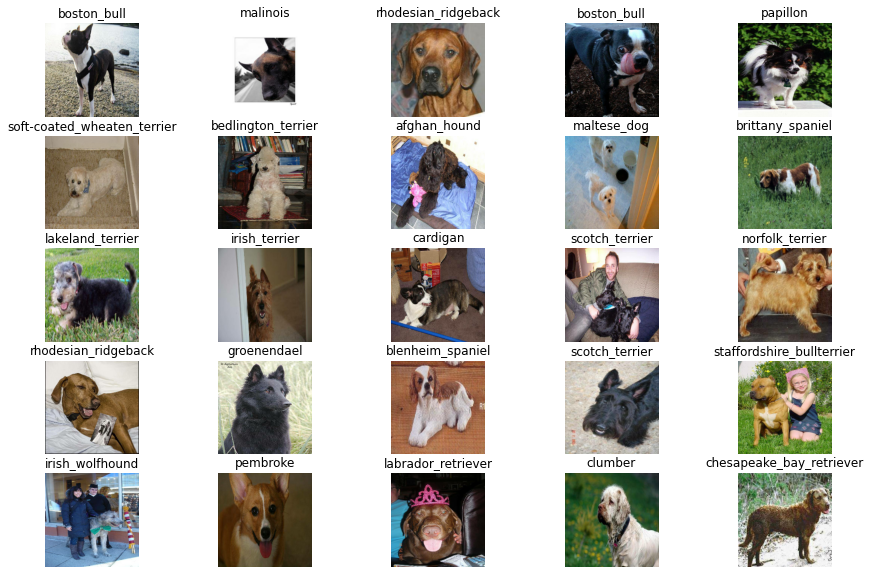

In [ ]:
#Now let's visualize the data in a training batch
train_images, train_labels = next(train_data.as_numpy_iterator())
#len(train_images), len(train_labels)
show_25_images(train_images, train_labels)

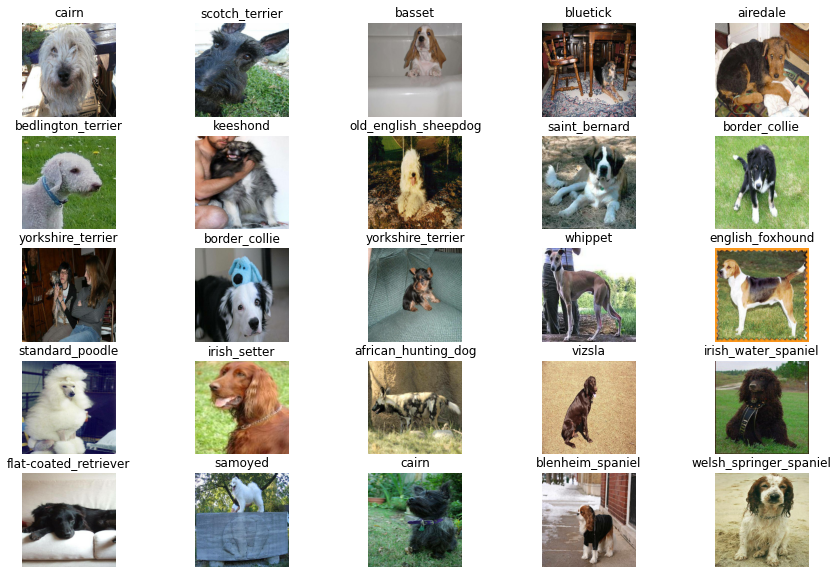

In [ ]:
#Now let's visualize the data in a validation batch
val_images, val_labels = next(valid_data.as_numpy_iterator())
#len(train_images), len(train_labels)
show_25_images(val_images, val_labels)

## Building a model
Before we build our model, there are few things we need to define
* The input shape(Our images shape in the form of tensors) to our model.
* The output shape(Image labels in the form of Tensors) of our model
* The URL of the model we want to use from TensorFlow Hub: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3]

# Setup out shape of our model
OUTPUT_SHAPE = len(unique_breed)

# Setup model URL from TensorFlow Hub. 
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"


Now we've got our Input, output and model ready, let's put them together into a keras deep learning model!

Knowing this, Let's create a function which:
* Takes the input shape, output shape and the ,model we've chosen as parameters
* Defines the layers in a keras model in a sequential fashion (That is a a linear sequential order (Do this first then that and so on))
* Compile the model (say how it should be evaluated and improved)
* Build the model(Tell the model the kind of input shapes it will be getting)
* Return the model

In [ ]:
# Create a function which builds a keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building Model wit", MODEL_URL)

  #setup the model layers
  model = tf.keras.Sequential([
                               hub.KerasLayer(MODEL_URL),# Layer 1 (input layer)
                               tf.keras.layers.Dense(units=OUTPUT_SHAPE, activation="softmax")# layer 2 (output layer)
                               ])

  #compile the model
  model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                 optimizer=tf.keras.optimizers.Adam(),
                 metrics= ["accuracy"]
                )
  # Build the model
  model.build(INPUT_SHAPE)

  return model



In [ ]:
model = create_model()
model.summary()

Building Model wit https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


### Creating Callbacks
Callbacks are helper functions a model can use during training to such things as save its progress, check its progress or stop training early if a model stops improving

we will create two callbacks, one for TensorBoard which helps to track the progress of our model, and another for early stopage which prevent our model from training too long

###TensorBoard Callback
 **To  setup a TensorBoard callback, we need to do three things:**
 1. Load the TensorBoard notbook extension
 2. Create a tensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function
 3. Visualize our models training logs with the `tensorboard` magic function(we'll do this after model training)


In [ ]:
#Load TensorBoard Notebook Extension
%load_ext tensorboard

In [ ]:
import datetime
# Create a funtion to build a TensorBoard callback
def create_tensorboard_callback():
  #create a log directory for storing TensorBoard logs
  logdir=os.path.join("gdrive/My Drive/dog_vision/logs", # make it so the logs get tracked whenever we run an experiment 
                      datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early stopping callback
Early stopping helps stops our model from overfitting by stopping training if a certain evaluation metric stops improving. https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping


In [ ]:
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", patience=3)

## Training a model(on subset of data)
Our first model is only going to train on 1000 images to make sure everything is working well

In [ ]:
NUM_EPOCHS = 100 #@param{type:"slider", min:10, max:100}

In [ ]:
#check to make sure we are still running on GPU
print("GPU", "Available (Yesssss!!!!!)" if tf.config.list_physical_devices("GPU") else "Not Avaialble :(")

GPU Available (Yesssss!!!!!)


**Let's create a function that trains a model**
* Create a model using `create_model()`
* Set up a TesnsorBoard callback using `create_tensoboard_callback()`
* Call the `fit()` function on our model, passing it the training data, validation data, number of epochs to train for (`NUM_EPOCHS`), and the callback we want to use
* Return the model

In [ ]:
# Build a function to train and return a trained model
def train_model():
  """
  Train a given model and return a trained version of it
  """
  #create a model
  model = create_model()

  #create   a new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback() 

  # fit the model to the data passing it the callbacks we created
  model.fit(x=train_data, 
            epochs=NUM_EPOCHS,
            validation_data=valid_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  #return the fitted model
  return model


In [ ]:
#fit the model to the data
model = train_model()

Building Model wit https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 129s 4s/step - loss: 4.4767 - accuracy: 0.1125 - val_loss: 3.3330 - val_accuracy: 0.2550
Epoch 2/100
25/25 [==============================] - 5s 189ms/step - loss: 1.5534 - accuracy: 0.7113 - val_loss: 2.1144 - val_accuracy: 0.4800
Epoch 3/100
25/25 [==============================] - 5s 202ms/step - loss: 0.5358 - accuracy: 0.9450 - val_loss: 1.6667 - val_accuracy: 0.5650
Epoch 4/100
25/25 [==============================] - 5s 199ms/step - loss: 0.2440 - accuracy: 0.9900 - val_loss: 1.4763 - val_accuracy: 0.6100
Epoch 5/100
25/25 [==============================] - 5s 188ms/step - loss: 0.1443 - accuracy: 0.9962 - val_loss: 1.4013 - val_accuracy: 0.6350
Epoch 6/100
25/25 [==============================] - 5s 187ms/step - loss: 0.0994 - accuracy: 0.9975 - val_loss: 1.3720 - val_accuracy: 0.6400
Epoch 7/100
25/25 [==============================] -

** It looks like our model is overfitting because it is performing better on the training dataset than on the validation datasets.** What are some ways to prevent data overfitting in deep learning neural networks?

Note that overfitting is a good thing because it means our model is learning

### Checking the TensorBoard logs

The TensorBoard magic function (`%tensorboard`) will access the logs directory we created earlier and visualize it's content

In [ ]:
%tensorboard --logdir gdrive/My\Drive/dog_vision/logs

<IPython.core.display.Javascript object>

### Making and evaluating predictions using a trained model

In [ ]:
#Make predictions on the validation data (This is not used to train on)
predictions = model.predict(valid_data, verbose=1)
predictions

7/7 [==============================] - 2s 160ms/step


array([[1.48703053e-03, 1.69039879e-04, 2.70764483e-03, ...,
        1.69044570e-03, 1.72635227e-05, 4.28177789e-03],
       [2.73233803e-04, 8.90558411e-04, 1.86379310e-02, ...,
        2.43978808e-04, 1.73916738e-03, 5.26047961e-06],
       [2.63468301e-05, 3.60099220e-05, 3.91666472e-05, ...,
        5.53736709e-06, 1.58858369e-04, 1.02879378e-04],
       ...,
       [3.55569773e-06, 2.63782440e-05, 9.95798382e-06, ...,
        2.21883620e-05, 4.79031442e-05, 4.00398421e-05],
       [3.48244631e-03, 1.88891849e-04, 2.40232970e-04, ...,
        3.04937421e-04, 4.80197086e-05, 3.75802303e-03],
       [1.58102979e-04, 1.19597265e-04, 2.45465752e-04, ...,
        1.15913348e-02, 6.85800740e-04, 9.64520441e-05]], dtype=float32)

In [ ]:
predictions.shape

(200, 120)

In [ ]:
predictions[0]

array([1.48703053e-03, 1.69039879e-04, 2.70764483e-03, 2.05290853e-04,
       2.97549792e-04, 9.88028405e-05, 2.20847856e-02, 5.70344855e-04,
       6.63003957e-05, 7.79508671e-04, 2.49122560e-04, 4.07065709e-05,
       1.78951057e-04, 1.18013641e-05, 1.40998967e-03, 1.10772147e-03,
       2.12109269e-04, 2.67337829e-01, 3.84574159e-05, 1.16492731e-04,
       4.49521409e-04, 4.94099746e-04, 2.30829119e-05, 1.44209759e-03,
       1.75126217e-04, 3.95466224e-04, 1.89550012e-01, 1.01567290e-04,
       5.05298201e-04, 4.60095733e-04, 2.46818381e-04, 2.46204808e-03,
       1.17529395e-04, 4.72505853e-05, 8.95928606e-05, 8.73235688e-02,
       2.83312838e-04, 3.54086165e-04, 2.35229338e-04, 8.49968928e-04,
       2.79127358e-04, 3.32325435e-05, 1.80435294e-04, 2.21323615e-04,
       2.13963373e-04, 7.41896802e-04, 5.28933742e-05, 3.44322121e-04,
       4.72517830e-04, 3.03039618e-04, 9.72782800e-05, 8.35028884e-04,
       1.15051144e-03, 5.32409504e-05, 4.45247162e-04, 1.14317969e-04,
      

In [ ]:
np.sum(predictions[0])


1.0

In [ ]:
from numpy.ma.core import argmax
# First prediction
index=0
print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[index])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[index])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[index])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breed[np.argmax(predictions[index])]}") # the predicted label

[1.48703053e-03 1.69039879e-04 2.70764483e-03 2.05290853e-04
 2.97549792e-04 9.88028405e-05 2.20847856e-02 5.70344855e-04
 6.63003957e-05 7.79508671e-04 2.49122560e-04 4.07065709e-05
 1.78951057e-04 1.18013641e-05 1.40998967e-03 1.10772147e-03
 2.12109269e-04 2.67337829e-01 3.84574159e-05 1.16492731e-04
 4.49521409e-04 4.94099746e-04 2.30829119e-05 1.44209759e-03
 1.75126217e-04 3.95466224e-04 1.89550012e-01 1.01567290e-04
 5.05298201e-04 4.60095733e-04 2.46818381e-04 2.46204808e-03
 1.17529395e-04 4.72505853e-05 8.95928606e-05 8.73235688e-02
 2.83312838e-04 3.54086165e-04 2.35229338e-04 8.49968928e-04
 2.79127358e-04 3.32325435e-05 1.80435294e-04 2.21323615e-04
 2.13963373e-04 7.41896802e-04 5.28933742e-05 3.44322121e-04
 4.72517830e-04 3.03039618e-04 9.72782800e-05 8.35028884e-04
 1.15051144e-03 5.32409504e-05 4.45247162e-04 1.14317969e-04
 9.48276647e-05 1.59653416e-03 3.64564912e-04 7.27128834e-02
 2.72799254e-04 3.01990167e-05 1.87052926e-03 2.41306370e-05
 9.48101224e-04 9.837438

Having the above functionalities is good, but we want to be able to do it at a scale. And it will be even better if we could see the image the prediction is being made on.

**Note:** Predictions probabilities are also known as confidence levels

In [ ]:
# Turn probabilities into their respective labels easier to understand
def get_pred_label(prediction_probabilities):
  """
  Turn an array of prediction probabilities into a label
  """
  return unique_breed[np.argmax(prediction_probabilities)]

#get a predicted label based on an array of predicted probabilities
pred_label =get_pred_label(predictions[0])
pred_label

NameError: ignored

Wonderful! Now we've got a list of all different predictions our model has made, we'll do the same for the validation images and validation labels.

Remember, the model hasn't trained on the validation data, during the `fit()` function, it only used the validation data to evaluate itself. So we can use the validation images to visually compare our models predictions with the validation labels.

Since our validation data (`valid_data`) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using [`unbatch()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#unbatch)) and then turn it into an iterator using [`as_numpy_iterator()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#as_numpy_iterator).

Let's make a small function to do so.

In [ ]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breed[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(valid_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Nailed it!

Now we've got ways to get:
* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's make some functions to make these all a bit more visualize.

More specifically, we want to be able to view an image, its predicted label and its actual label (true label).

The first function we'll create will:
* Take an array of prediction probabilities, an array of truth labels, an array of images and an integer.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and target image on a single plot.

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  
  # Get the pred label
  pred_label = get_pred_label(pred_prob)
  
  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

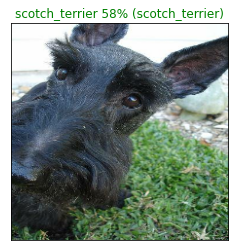

In [ ]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,)

Nice! Making functions to help visual your models results are really helpful in understanding how your model is doing.

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

Let's build a function to demonstrate. The function will:
* Take an input of a prediction probabilities array, a ground truth labels array and an integer.
* Find the predicted label using `get_pred_label()`.
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probability values and labels, coloring the true label green.

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breed[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

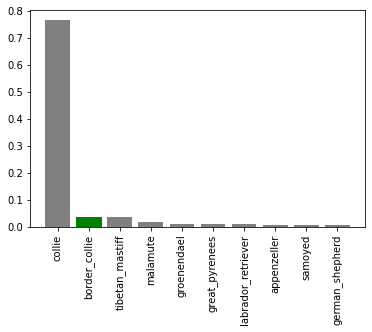

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Wonderful! Now we've got some functions to help us visualize our predictions and evaluate our model, let's check out a few.

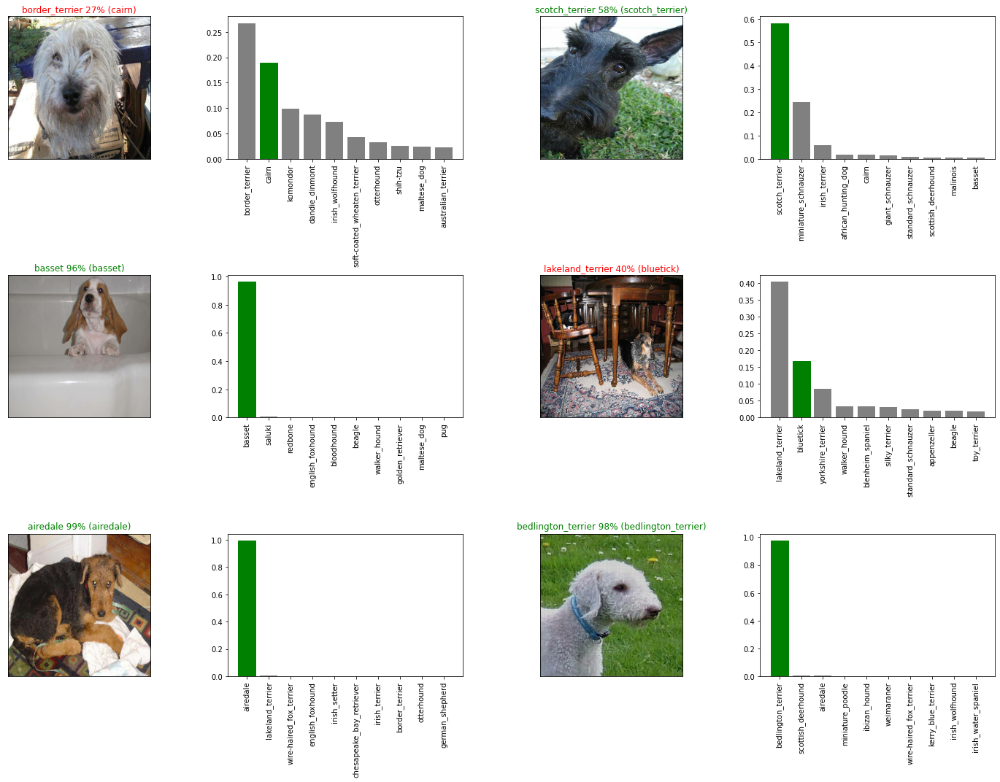

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a model

After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an [entire saved Keras model is h5](https://www.tensorflow.org/tutorials/keras/save_and_load). So we'll make a function which can take a model as input and utilise the [`save()`](https://www.tensorflow.org/tutorials/keras/save_and_load#savedmodel_format) method to save it as a h5 file to a specified directory.

In [ ]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("gdrive/My Drive/dog_vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

If we've got a saved model, we'd like to load it, let's create a function which can take a model path and use the [`tf.keras.models.load_model()`](https://www.tensorflow.org/api_docs/python/tf/keras/models/load_model) function to load it into the notebook.

Because we're using a component from TensorFlow Hub (`hub.KerasLayer`) we'll have to pass this as a parameter to the `custom_objects` parameter.

In [ ]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: gdrive/My Drive/dog_vision/models/20220506-09131651828437-1000-images-Adam.h5...


'gdrive/My Drive/dog_vision/models/20220506-09131651828437-1000-images-Adam.h5'

In [ ]:
# Load our model trained on 1000 images
model_1000_images = load_model('gdrive/My Drive/dog_vision/models/20220504-17471651686426-1000-images-Adam.h5')

Loading saved model from: gdrive/My Drive/dog_vision/models/20220504-17471651686426-1000-images-Adam.h5


Compare the two models (the original one and loaded one). We can do so easily using the `evaluate()` method.

In [ ]:
# Evaluate the pre-saved model
model.evaluate(valid_data)

7/7 [==============================] - 1s 121ms/step - loss: 1.2399 - accuracy: 0.6750


[1.2398772239685059, 0.675000011920929]

In [ ]:
# Evaluate the loaded model
model_1000_images.evaluate(valid_data)

7/7 [==============================] - 2s 124ms/step - loss: 1.2786 - accuracy: 0.6850


[1.2785727977752686, 0.6850000023841858]

## Training a model (on the full data)

Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to `X` and all of the training labels to `y`. Let's check them out.

In [ ]:
# Remind ourselves of the size of the full dataset
len(x), len(y)

(10222, 10222)

There we go! We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a data batch.

The beautiful thing is, we can use our `create_data_batches()` function from above which also preprocesses our images for us (thank you past us for writing a helpful function).

In [ ]:
# Turn full training data in a data batch
full_data = create_data_batches(x, y)

creating train data batches


Our data is in a data batch, all we need now is a model.

And surprise, we've got a function for that too! Let's use `create_model()` to instantiate another model. 

In [ ]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building Model wit https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


Since we've made a new model instance, full_model, we'll need some callbacks too.

In [ ]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

To monitor the model whilst it trains, we'll load TensorBoard (it should update every 30-seconds or so whilst the model trains).

In [ ]:
%tensorboard --logdir gdrive/My\ Drive/dog_vision/logs

<IPython.core.display.Javascript object>

**Note:** Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish. However, thanks to our `full_model_early_stopping` callback, it'll stop before it starts going too long.

Remember, the first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.

In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 55s 159ms/step - loss: 1.3278 - accuracy: 0.6758
Epoch 2/100
320/320 [==============================] - 53s 164ms/step - loss: 0.4023 - accuracy: 0.8808
Epoch 3/100
320/320 [==============================] - 53s 164ms/step - loss: 0.2385 - accuracy: 0.9349
Epoch 4/100
320/320 [==============================] - 51s 160ms/step - loss: 0.1553 - accuracy: 0.9637
Epoch 5/100
320/320 [==============================] - 50s 156ms/step - loss: 0.1056 - accuracy: 0.9790
Epoch 6/100
320/320 [==============================] - 56s 173ms/step - loss: 0.0782 - accuracy: 0.9874
Epoch 7/100
320/320 [==============================] - 55s 172ms/step - loss: 0.0578 - accuracy: 0.9920
Epoch 8/100
320/320 [==============================] - 55s 171ms/step - loss: 0.0468 - accuracy: 0.9935
Epoch 9/100
320/320 [==============================] - 56s 175ms/step - loss: 0.0369 - accuracy: 0.9962
Epoch 10/100
320/320 [==============================] - 56s 174m

### Saving and reloading the full model

Even on a GPU, our full model took a while to train. So it's a good idea to save it.

We can do so using our `save_model()` function.

**Challenge:** It may be a good idea to incorporate the `save_model()` function into a `train_model()` function. Or look into setting up a [checkpoint callback](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ModelCheckpoint).

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving model to: gdrive/My Drive/dog_vision/models/20220506-09351651829740-all-images-Adam.h5...


'gdrive/My Drive/dog_vision/models/20220506-09351651829740-all-images-Adam.h5'

In [ ]:
# Load in the full model
loaded_full_model = load_model('gdrive/My Drive/dog_vision/models/20220506-09351651829740-all-images-Adam.h5')

Loading saved model from: gdrive/My Drive/dog_vision/models/20220506-09351651829740-all-images-Adam.h5


### Making predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data, we'll:
* Get the test image filenames.
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since there are no labels with the test images).
* Make a predictions array by passing the test data batches to the `predict()` function.

In [ ]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "gdrive/My Drive/dog_vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['gdrive/My Drive/dog_vision/test/e079440ee0061b92ec22faf17be13908.jpg',
 'gdrive/My Drive/dog_vision/test/deaf748bed865ec76758f086db04bfac.jpg',
 'gdrive/My Drive/dog_vision/test/e1f9be3ecf0409189486c786ff4bd65a.jpg',
 'gdrive/My Drive/dog_vision/test/dfc9bcbafc1e249cd07a25c8f50384e0.jpg',
 'gdrive/My Drive/dog_vision/test/e70c62f51defaa5295fe3e52099c4ce3.jpg',
 'gdrive/My Drive/dog_vision/test/e7afb35b8252782013a6700e28e327fa.jpg',
 'gdrive/My Drive/dog_vision/test/def9a16cb97a7cdd10d6465d642f6bf4.jpg',
 'gdrive/My Drive/dog_vision/test/e6ec1891d8f52a13683c73cabd3045cb.jpg',
 'gdrive/My Drive/dog_vision/test/dd3eb4338145e614d325a917a35e5a1e.jpg',
 'gdrive/My Drive/dog_vision/test/e293d06016cac647cd289e2008a4623a.jpg']

In [ ]:
# How many test images are there?
len(test_filenames)

10357

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

creating test data batches


**Note:** Since there are 10,000+ test images, making predictions could take a while, even on a GPU. So beware running the cell below may take up to an hour.

In [ ]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 188s 545ms/step


### Preparing test dataset predictions for Kaggle

Looking at the [Kaggle sample submission](https://www.kaggle.com/c/dog-breed-identification/overview/evaluation), it looks like they want the models output probabilities each for label along with the image ID's.

To get the data in this format, we'll:
*   Create a pandas DataFrame with an ID column as well as a column for each dog breed.
*   Add data to the ID column by extracting the test image ID's from their filepaths.
* Add data (the prediction probabilities) to each of the dog breed columns using the `unique_breeds` list and the `test_predictions` list.
* Export the DataFrame as a CSV to submit it to Kaggle.


In [ ]:
preds_df = pd.DataFrame(columns=["id"] + list(unique_breed))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
# Append test image ID's to predictions DataFrame
test_path = "gdrive/My Drive/dog_vision/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e079440ee0061b92ec22faf17be13908,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,deaf748bed865ec76758f086db04bfac,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e1f9be3ecf0409189486c786ff4bd65a,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,dfc9bcbafc1e249cd07a25c8f50384e0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e70c62f51defaa5295fe3e52099c4ce3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breed)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e079440ee0061b92ec22faf17be13908,1.862485e-10,4.868320e-08,5.889592e-11,2.637590e-17,1.428542e-10,2.611970e-15,2.319146e-11,8.570997e-09,6.870399e-11,...,2.935069e-09,1.742921e-10,1.120515e-13,3.194624e-11,1.295214e-11,1.319365e-10,5.426658e-07,1.812214e-13,7.613383e-12,3.117787e-12
1,deaf748bed865ec76758f086db04bfac,6.920694e-11,9.996443e-01,8.155713e-09,1.411233e-07,9.831005e-10,2.252302e-09,4.750198e-08,1.090564e-09,1.283568e-08,...,5.418616e-09,1.972248e-10,8.875807e-08,1.299586e-08,8.560841e-08,8.648431e-08,1.268808e-11,8.337604e-08,6.158085e-10,3.565109e-07
2,e1f9be3ecf0409189486c786ff4bd65a,2.871081e-08,6.523103e-12,4.170216e-09,2.047483e-12,4.570293e-10,3.633869e-08,8.837011e-08,4.281754e-07,8.509410e-10,...,8.376721e-07,3.628337e-05,1.382421e-09,1.149865e-11,1.202420e-09,1.595826e-08,1.725926e-09,1.970183e-08,9.176798e-11,1.655955e-06
3,dfc9bcbafc1e249cd07a25c8f50384e0,8.991940e-07,2.792795e-09,1.416449e-08,2.982057e-06,8.598370e-07,6.022440e-09,9.488375e-01,4.328293e-07,5.658843e-09,...,2.432753e-07,7.029092e-05,3.348499e-08,1.926969e-07,3.765528e-09,3.381018e-08,4.165149e-06,7.560247e-09,3.262690e-07,4.993358e-02
4,e70c62f51defaa5295fe3e52099c4ce3,4.411655e-12,1.355343e-09,3.402373e-08,8.389070e-11,2.964917e-10,2.351840e-10,1.337604e-10,1.115095e-07,7.195754e-11,...,1.469483e-10,3.326804e-08,8.899439e-12,6.957002e-10,3.633975e-10,6.031611e-10,3.552740e-10,1.288221e-09,1.358277e-07,4.811790e-11


Boom! Let's now export our predictions DataFrame to CSV so we can submit it to Kaggle.

In [ ]:
preds_df.to_csv("gdrive/My Drive/dog_vision/full_submission_1_mobilienetV2_adam.csv",
                 index=False)

## Making predictions on custom images

It's great being able to make predictions on a test dataset already provided for us.

But how could we use our model on our own images?

The premise remains, if we want to make predictions on our own custom images, we have to pass them to the model in the same format the model was trained on.

To do so, we'll:
* Get the filepaths of our own images.
* Turn the filepaths into data batches using `create_data_batches()`. And since our custom images won't have labels, we set the `test_data` parameter to `True`.
* Pass the custom image data batch to our model's `predict()` method.
* Convert the prediction output probabilities to prediction labels.
* Compare the predicted labels to the custom images.

**Note:** To make predictions on custom images, I've uploaded pictures of my own to a directory located at `drive/My Drive/Data/dogs/` (as seen in the cell below). In order to make predictions on your own images, you will have to do something similar.

In [ ]:
# Get custom image filepaths
custom_path = "gdrive/My Drive/dog_vision/dogs/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths, test_data=True)

creating test data batches


In [ ]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

Now we've got some predictions arrays, let's convert them to labels and compare them with each image.

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['rottweiler', 'kuvasz', 'german_shepherd', 'great_dane']

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

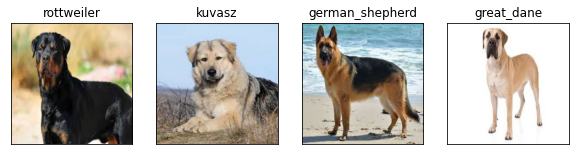

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 4, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)